<a href="https://colab.research.google.com/github/salmanoglubatuhan/detectron2-faster-rcnn-with-stanford-dataset/blob/main/detectron2_main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

In [ ]:
# install dependencies: 
!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

In [ ]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.7)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
import torch
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
!unzip /content/drive/MyDrive/VisDrone2019-DET-train.zip -d /content/

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train5", {}, "/content/drive/MyDrive/visdronecoco.json", "/content/VisDrone2019-DET-train/images")
#register_coco_instances("my_dataset_val2", {}, "/content/drive/MyDrive/1000 'lik dataset/val.json", "/content/drive/MyDrive/1000 'lik dataset/val")

In [ ]:
path_to_annotations = "/content/drive/MyDrive/visdronecoco.json"
path_to_images = "/content/VisDrone2019-DET-train/images"

In [ ]:
import json
from pathlib import Path
from PIL import Image as PILImage
import IPython
import numpy as np
from math import trunc
import base64
from io import BytesIO

In [ ]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train5",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0015  # pick a good LR
cfg.SOLVER.MAX_ITER = 2000    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 12  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.4   # set a custom testing threshold
cfg.DATASETS.TEST = ("my_dataset_val2", )
predictor = DefaultPredictor(cfg)

In [ ]:
mydata_metadata = MetadataCatalog.get("my_dataset_val2")
dataset_dicts = DatasetCatalog.get("my_dataset_val2")

[02/17 17:17:59 d2.data.datasets.coco]: Loaded 128 images in COCO format from /content/drive/MyDrive/1000 'lik dataset/val.json


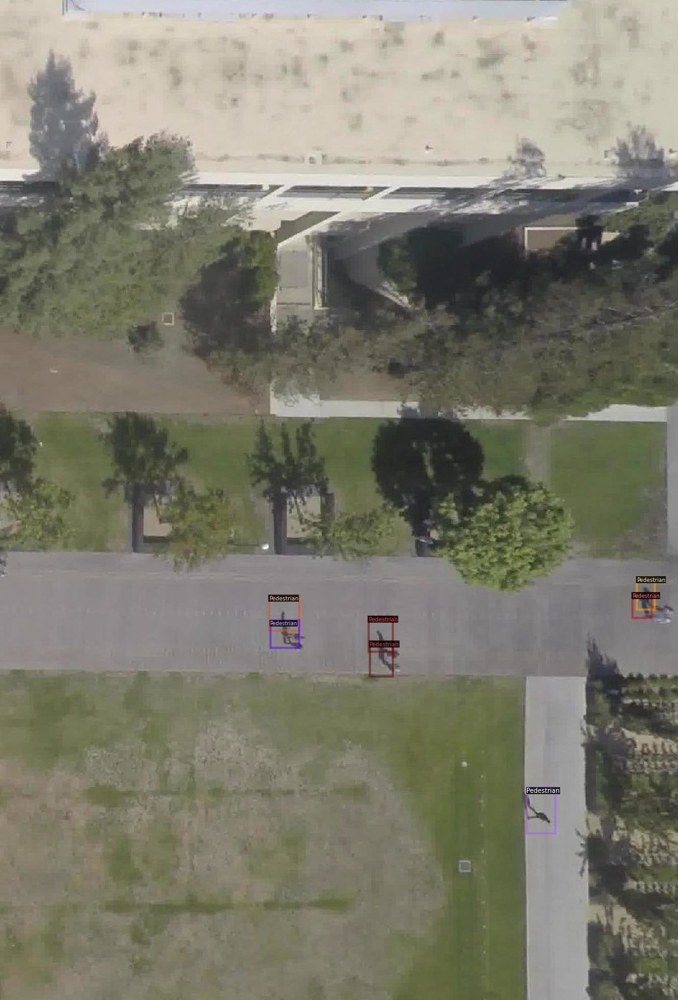

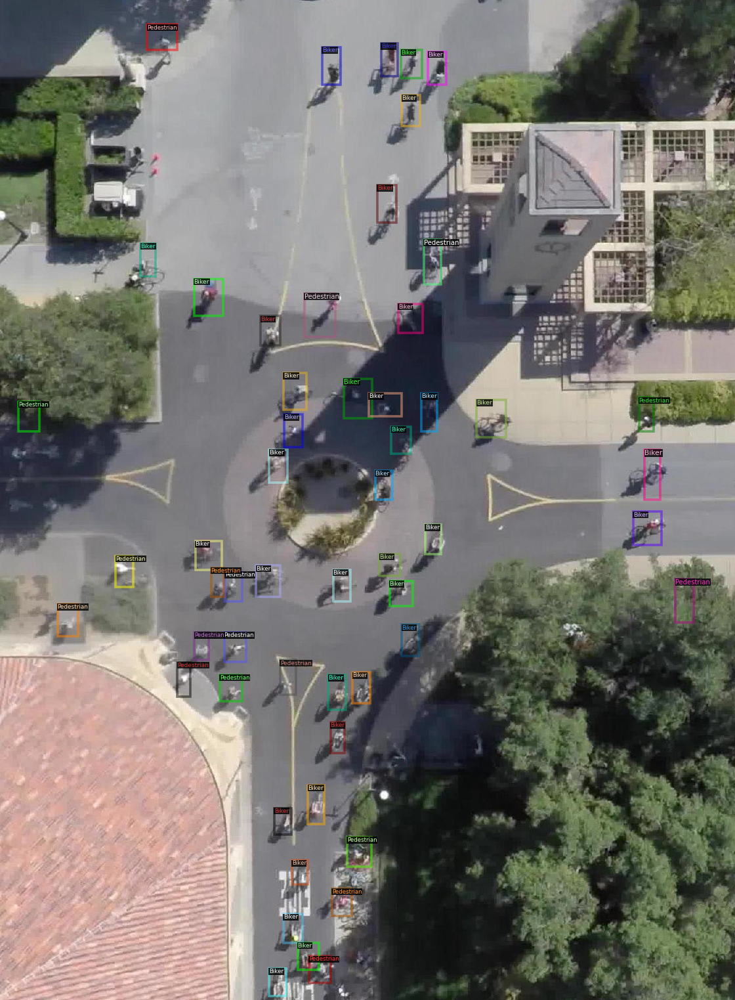

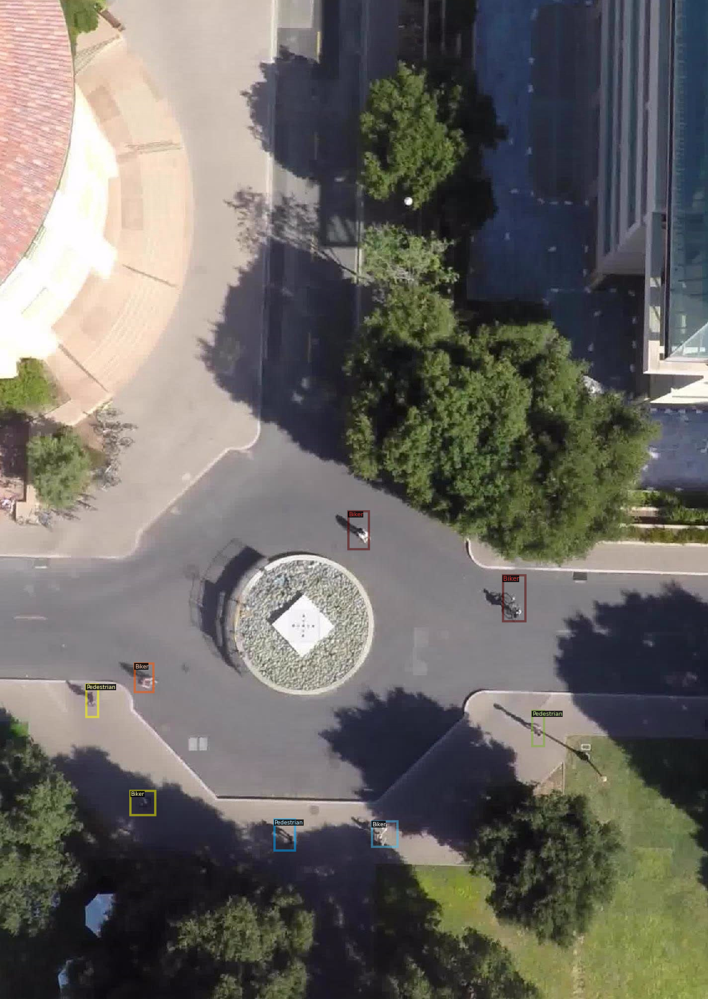

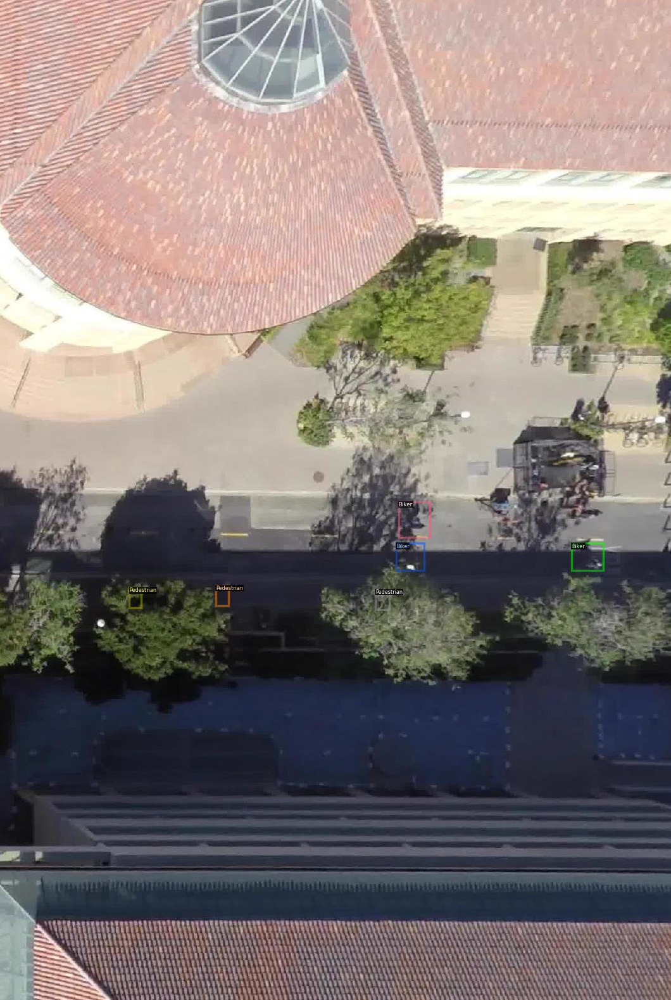

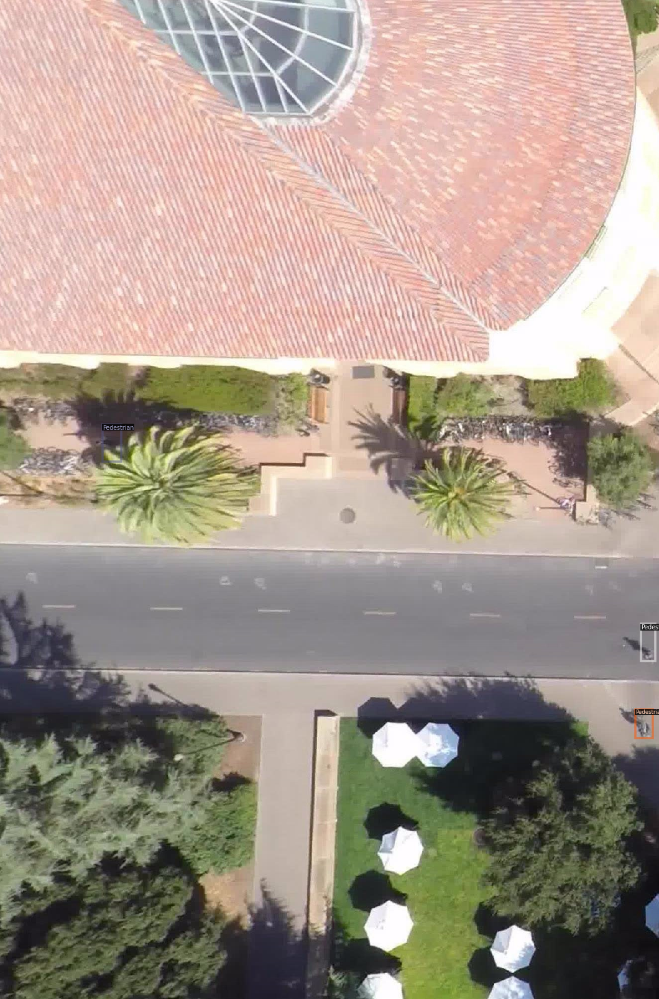

...

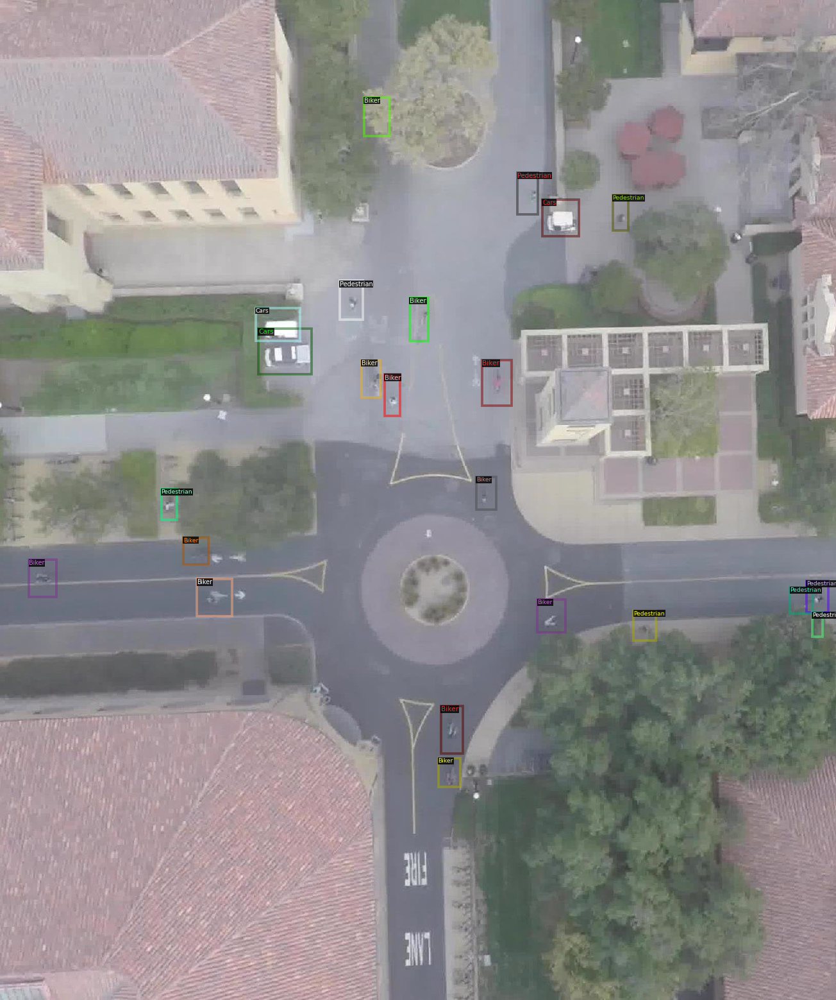

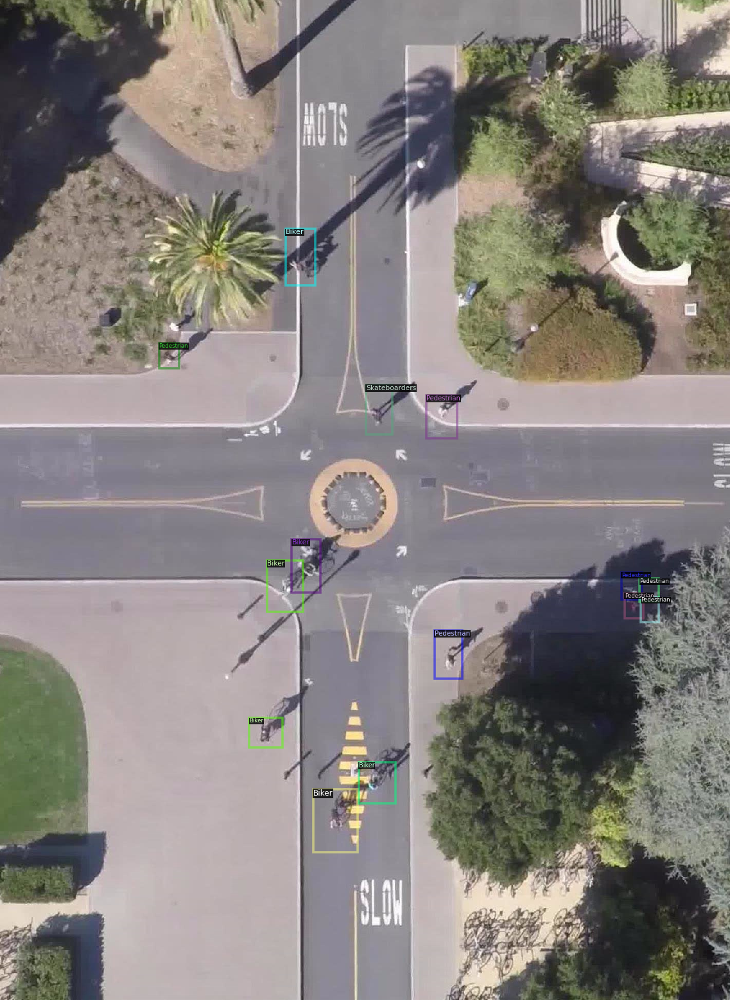

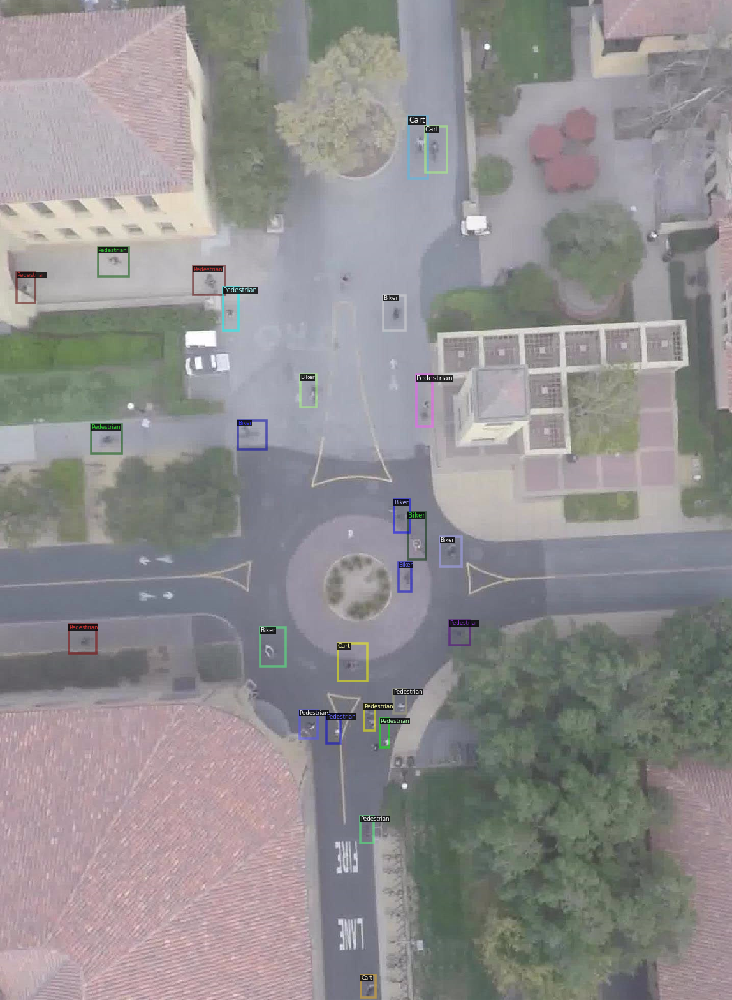

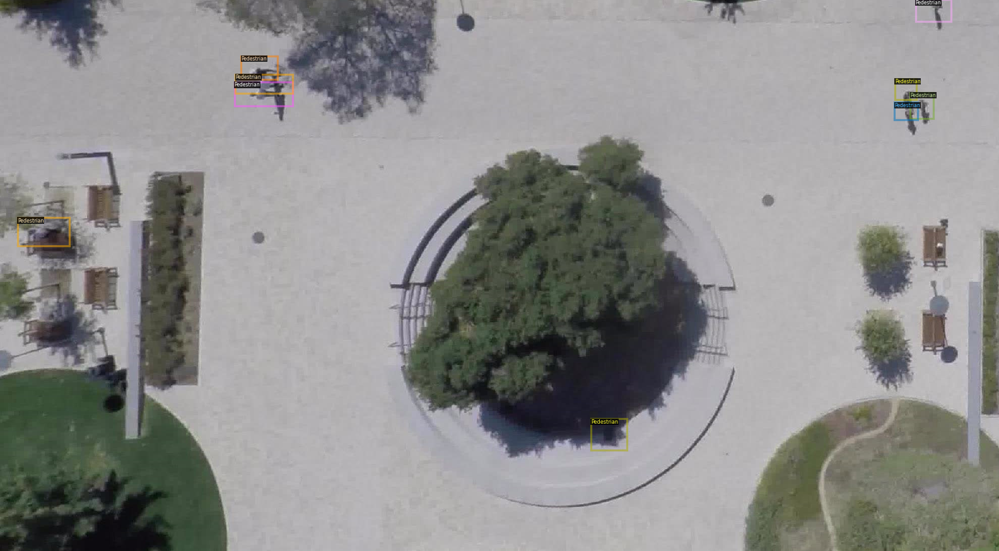

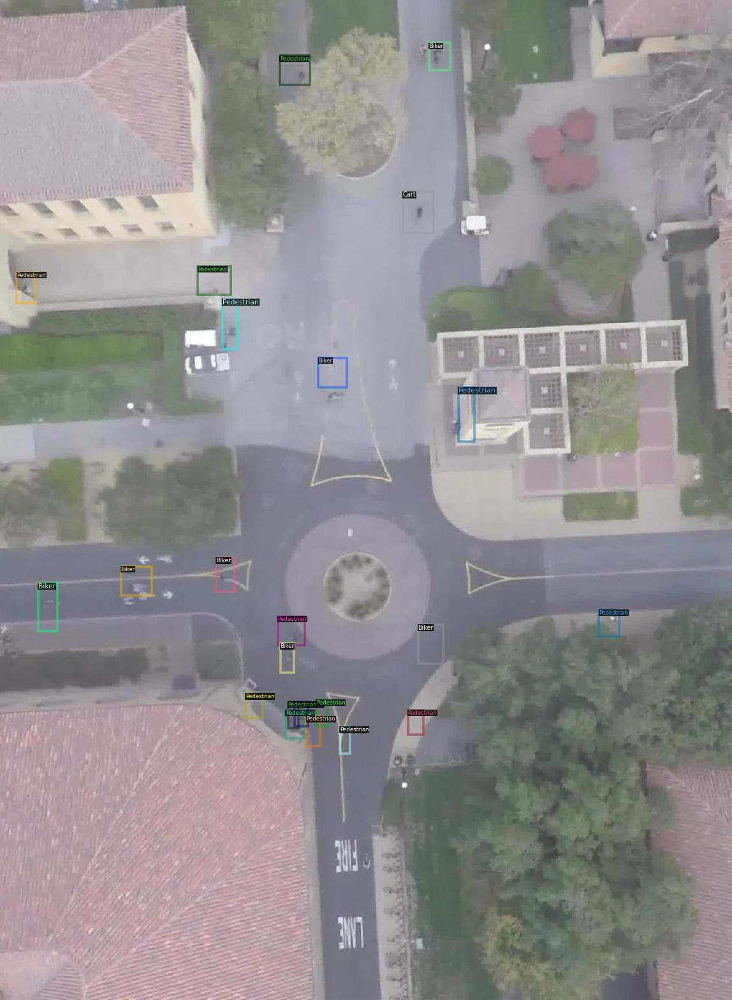

In [ ]:
import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 15):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=mydata_metadata, scale=0.8)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import numpy as np
import tqdm
import cv2
from detectron2.utils.visualizer import ColorMode

In [ ]:
video_path = '/content/drive/MyDrive/data-yolov5/videos/deathCircle/video2/video.mov'

In [ ]:
video = cv2.VideoCapture(video_path)
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
frames_per_second = video.get(cv2.CAP_PROP_FPS)
num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))

In [ ]:
video_writer = cv2.VideoWriter('final75.mp4', fourcc=cv2.VideoWriter_fourcc(*"mp4v"), fps=float(frames_per_second), frameSize=(width, height), isColor=True)
# predictor defined above as predictor = DefaultPredictor(cfg)

In [ ]:
metadata = MetadataCatalog.get("my_dataset_val2")

In [ ]:
def runOnVideo(video, maxFrames):
    """ Runs the predictor on every frame in the video (unless maxFrames is given),
    and returns the frame with the predictions drawn.
    """

    readFrames = 0
    while True:
        hasFrame, frame = video.read()
        if not hasFrame:
            print('No Frame Left')
            break
        if readFrames % 100 == 0:
            print(f'{readFrames} frames processed')

        outputs = predictor(frame)

        frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)

        v = Visualizer(frame[:, :, ::-1],
                   metadata=metadata, 
                   scale=1, 
                   instance_mode=ColorMode.IMAGE_BW 
        )
        v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
        v = v.get_image()[:, :, ::-1]
        
        visualization = cv2.cvtColor(v, cv2.COLOR_RGB2BGR)
        
        video_writer.write(visualization)

        readFrames += 1
        if maxFrames != -1 and readFrames > maxFrames:
            print('Max Frame Limit!')
            break

In [ ]:
num_frames = 75

runOnVideo(video, num_frames)

print('Process is Over')
video.release()
video_writer.release()
cv2.destroyAllWindows()

0 frames processed
Max Frame Limit!
Process is Over


In [ ]:
from google.colab import files
files.download('/content/output/model_final.pth')